# Time Series Forecasting - Temperature Forecast for Dahlem


## The Business Goal

Build a model that can predict the next day's temperature as precisely as possible.

## Contents

Step 1 - Loading the Data & Initial Exploration

Step 2 - Cleaning the Data

Step 3 - Data Exploration & Plotting

Step 4 - Choosing a model

Step 5 - Train-Test-Split

Step 6 - Feature Engineering to Model the Trend and Seasonality

Step 7 - Inspectig the Remainder to Confirm Use of Linear Autoregression Model

Step 8 - Step 8 - Determining the Number of Lags - Box-Jenkins Methodology (ACF, PCF)

Step 9 - Evaluating our Model with Cross-Validation

Step 10 - Runnning the AR(3) Model on the Test-Set

Step 11 - Combining the Train- and Test-Set and Re-Training the Model

Step 12 - Temperature Forecast for the next day

## Imports

In [1]:
#imports 

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pylab import rcParams
import warnings
warnings.simplefilter(action='ignore')

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import TimeSeriesSplit, cross_val_score
from sklearn.metrics import r2_score

from statsmodels.tsa.ar_model import ar_select_order, AutoReg
from statsmodels.tsa.stattools import adfuller, acf, pacf
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from statsmodels.tsa.arima_model import ARIMA,ARIMAResults,ARMA,ARMAResults
from statsmodels.tsa.statespace.sarimax import SARIMAX
import statsmodels.api as sm

from pmdarima.arima import auto_arima

# Set figure size to (14,6)
plt.rcParams['figure.figsize'] = (14,6)
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [2]:
# custom plot function

def plot_timeseries(df, title="", ylim=True):
    """
    Custom plotting function for plotting the temperature data set
    
    Parameters
    ----------
    df : pd.DataFrame
        The data to plot.
    title : str
        The title of the plot
    ylim : bool
        Whether to fix the minimum value of y; defalut is True
    
    Returns
    -------
    Plots the data
    
    """
    
    df.plot(linestyle='--', marker='o')
    plt.title(title)
    if ylim:
        plt.ylim(ymin=0)
    plt.ylabel("Passengers in 1000s")
    plt.show()

## Step 1 - Loading the Data & Initial Exploration
The text file with the daily temperature values for Berlin Dahlem from 1876 to May 2021 was downloaded from [www.ecad.eu](https://www.ecad.eu 'go to page').

In [3]:
weather = pd.read_csv('data/weather_dahlem.txt')
weather.head()

,SOUID,DATE,TG,Q_TG
0,127488,18760101,22,0
1,127488,18760102,25,0
2,127488,18760103,3,0
3,127488,18760104,-58,0
4,127488,18760105,-98,0


In [4]:
weather.tail()

,SOUID,DATE,TG,Q_TG
53107,100133,20210527,115,0
53108,100133,20210528,112,0
53109,100133,20210529,120,0
53110,100133,20210530,140,0
53111,100133,20210531,141,0


In [5]:
# checking for null values 

weather.isnull().sum()

 SOUID      0
    DATE    0
   TG       0
 Q_TG       0
dtype: int64

In [6]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53112 entries, 0 to 53111
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype
---  ------    --------------  -----
 0    SOUID    53112 non-null  int64
 1       DATE  53112 non-null  int64
 2      TG     53112 non-null  int64
 3    Q_TG     53112 non-null  int64
dtypes: int64(4)
memory usage: 1.6 MB


### Conclusions: 
* the data set has no missing values
* the column names were not parsed correctly from the text file, it would be hard to work with names containing spaces 
* for our purposes the SQUID and the Q_TG columns are irrelevant and can be deleted 
* for our purposes the last 50 years of weather data suffice as a base to make accurate predictions

## Step 2 - Cleaning the Data

In [7]:
# creating columns with correct names

weather['date'] = weather['    DATE']
weather['temp'] = weather['   TG']

# deleting superfluous columns

weather.drop(['    DATE'], axis = 1, inplace = True)
weather.drop(['   TG'], axis = 1, inplace = True)
weather.drop([' SOUID',' Q_TG'], axis = 1, inplace = True)

# parsing the date column with the correct datetime format

weather['date'] = pd.to_datetime(weather['date'], format = '%Y%m%d')

# set the date as index
weather.set_index('date', inplace = True)

# making a new data frame from the last 50 years of data 

weather_50y = weather.loc['1971':]

## Step 3 - Data Exploration & Plotting

In [8]:
weather_50y.shape

(18414, 1)

In [9]:
weather_50y.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 18414 entries, 1971-01-01 to 2021-05-31
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   temp    18414 non-null  int64
dtypes: int64(1)
memory usage: 287.7 KB


The data set is now sufficiently cleaned.

In [10]:
# adjusting temperature for 2 digit values
weather_50y['temp'] = weather_50y['temp'] * 0.1

In [11]:
weather_50y.head()

,temp
date,
1971-01-01,-9.5
1971-01-02,-9.6
1971-01-03,-14.4
1971-01-04,-11.7
1971-01-05,-8.3


In [12]:
weather_50y.describe()

,temp
count,18414.000000
mean,9.567145
std,7.555196
min,-17.900000
25%,3.800000
50%,9.600000
75%,15.500000
max,29.500000


Saving the data frame to a CSV-file

In [13]:
weather_50y.to_csv(r'./data/weather_50y.csv')

<AxesSubplot:xlabel='date'>

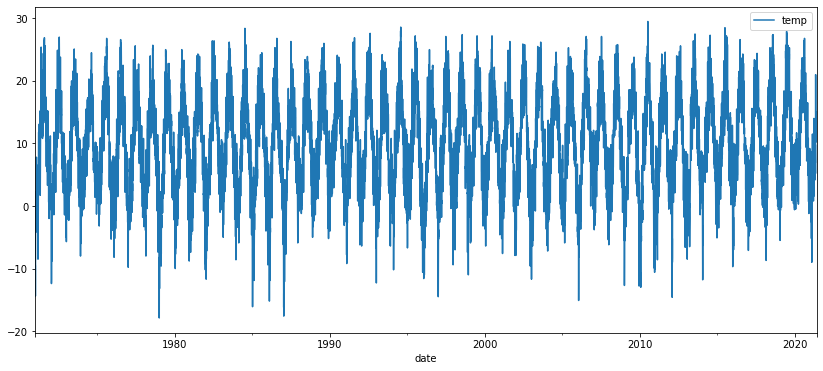

In [14]:
weather_50y.plot()

Note: Regular pattern of the data in the long-term

<AxesSubplot:xlabel='date'>

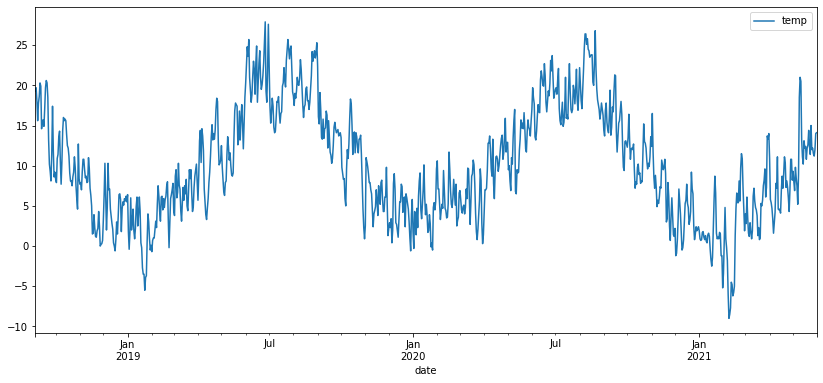

In [15]:
# zooming in to observe pattern in the mid-term
weather_50y.iloc[-1000:].plot()

Note: Regular patterns with some randomness in the mid-term

### Plotting the mean of years and months

<AxesSubplot:xlabel='date'>

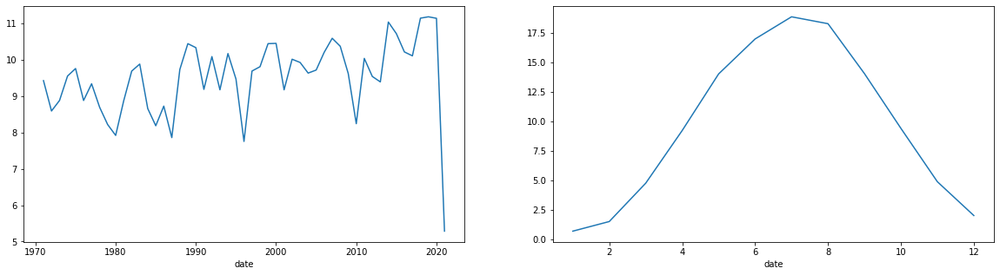

In [16]:
fig,(ax1,ax2) = plt.subplots(ncols=2)
fig.set_size_inches(20, 5)
weather_50y.groupby(weather_50y.index.year)['temp'].mean().plot(ax=ax1)
weather_50y.groupby(weather_50y.index.month)['temp'].mean().plot(ax=ax2)

Note: 
Yearly mean temperature folows an upward trend.
Monthly mean temperature shows clear seasonal patterns.

\* Steep fall in 2021 is caused by the fact that the data was collected until the half of the year. 

<Figure size 576x288 with 0 Axes>

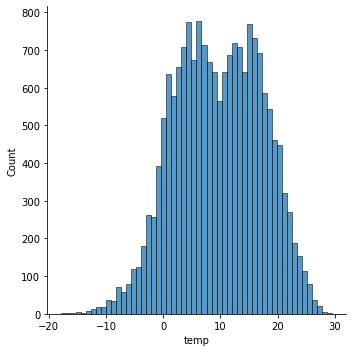

In [17]:
plt.figure(figsize=(8,4))
sns.displot(weather_50y["temp"])

Note: The temperature is evenly distributed around the mean of 9.57.

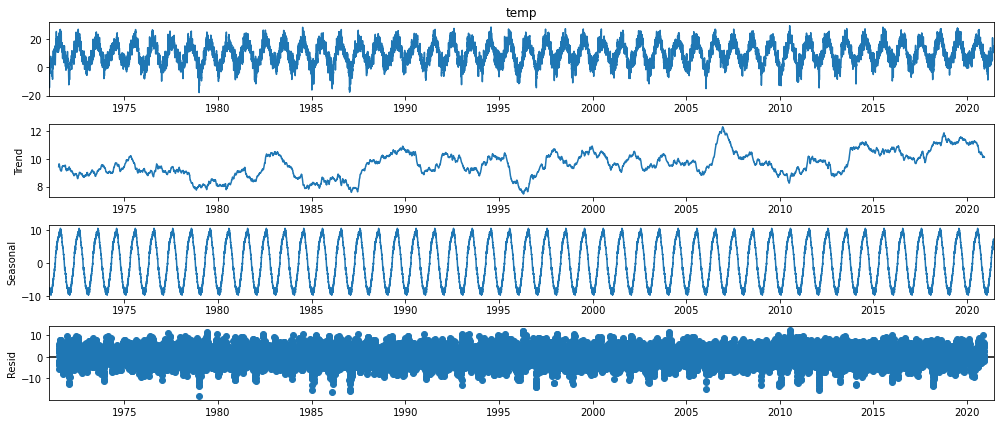

In [18]:
decomposition = sm.tsa.seasonal_decompose(weather_50y['temp'], model='additive',period=365)
fig = decomposition.plot()
plt.show()

Conclusion: 
As expected the observations have a clear time dependence and seasonality: 
* Temperature can only climb/fall a certain maximum amount throghout the duration of one day. This causes the following day's temperature to be strongly dependent on the previous days.
* The observations follow a trend 
* In the target region, Berlin Dahlem, the year follows a clear 4 seasons pattern every year.
* The seasonal variation stays roughly the same

## Step 4 - Choosing a model

The above exploration hints that it a linear autoregression model could be a good choice, since the data shows that there some dependency between the observation that lie close together. We will further explore this after the train test split and a decomposition of the data.

## Step 5 - Train-Test-Split
To keep prevent data leakage and thus minimzing the risk of overfitting, we divide the data into a training and a test set.
We are choosing the previous year as a test set.

In [19]:
df = weather_50y

In [20]:
df_train = df[:-365]

df_test = df[-365:]

## Step 6 - Feature Engineering to Model the Trend and Seasonality
We are interested in the decompostion of the time series into components that represent the before mentioned patterns:
* trend: long term increase or decrease not of a fixed frequency 
* seasonal: seasonal effects of fixed and known frequency
* remainder: whatever is leftover

There are these possibilities of dependence between the patterns over time:

Trend - $T_t$

Season - $S_t$

Remainder - $R_t$

### Additive - suitable if the variance stays constant over time

$ y_t = S_t + T_t + R_t $

### Multiplicative - suitable if the variance increases/decreases over time

$ y_t = S_tT_tR_t $

### During the visual data exploratino we discovered that the seaonal variation stays constant over time, therefore we are using an additive model.

To anylse a trend in the training and test set we introduce a new fetaure: the timestep, which makes the sequence of the observations more obvious than the time stamp containing the date.

In [21]:
# add timestep feature = trend

pd.options.mode.chained_assignment = None

df_train['timestep'] = list(range(len(df_train)))
last_train_timestep = df_train['timestep'].max() 
df_test['timestep'] = list(range(last_train_timestep + 1, len(df_test) + last_train_timestep + 1))

df_train.head()

,temp,timestep
date,,
1971-01-01,-9.5,0
1971-01-02,-9.6,1
1971-01-03,-14.4,2
1971-01-04,-11.7,3
1971-01-05,-8.3,4


In [22]:
df_test.head()

,temp,timestep
date,,
2020-06-01,17.0,18049
2020-06-02,19.7,18050
2020-06-03,18.5,18051
2020-06-04,17.7,18052
2020-06-05,13.6,18053


### Next we will extract the months as a categorical feature from the timestamp to utilize them as a period for seasonality.

In [23]:
pd.options.mode.chained_assignment = None

# add month feature and convert to hot-one encoding 
df_train['month'] = df_train.index.month_name()
df_test['month'] = df_test.index.month_name()

df_train = pd.get_dummies(df_train, prefix='', prefix_sep='')
df_test = pd.get_dummies(df_test, prefix='', prefix_sep='')

df_train.head(3)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September
date,,,,,,,,,,,,,,
1971-01-01,-9.5,0,0,0,0,0,1,0,0,0,0,0,0,0
1971-01-02,-9.6,1,0,0,0,0,1,0,0,0,0,0,0,0
1971-01-03,-14.4,2,0,0,0,0,1,0,0,0,0,0,0,0


In [24]:
df_test.head(3)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September
date,,,,,,,,,,,,,,
2020-06-01,17.0,18049,0,0,0,0,0,0,1,0,0,0,0,0
2020-06-02,19.7,18050,0,0,0,0,0,0,1,0,0,0,0,0
2020-06-03,18.5,18051,0,0,0,0,0,0,1,0,0,0,0,0


Modelig Trend and Seasonality with Linear Regression

In order to model the trend and sesonality we will run a linear regression model on our data frame containing the new features.

In [25]:
# define features and targets, instantiate model

X = df_train.drop('temp', axis=1)
y = df_train['temp']

m_trend_seasonal = LinearRegression()

In [26]:
# train model and add predictions as a column trend_seasonal

m_trend_seasonal.fit(X, y)

df_train['trend_seasonal'] = m_trend_seasonal.predict(X)

df_train.head(2)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal
date,,,,,,,,,,,,,,,
1971-01-01,-9.5,0,0,0,0,0,1,0,0,0,0,0,0,0,-0.197951
1971-01-02,-9.6,1,0,0,0,0,1,0,0,0,0,0,0,0,-0.197855


In [27]:
X_test = df_test.drop('temp', axis=1)

In [28]:
df_test['trend_seasonal'] = m_trend_seasonal.predict(X_test)

df_test.head(2)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal
date,,,,,,,,,,,,,,,
2020-06-01,17.0,18049,0,0,0,0,0,0,1,0,0,0,0,0,17.833293
2020-06-02,19.7,18050,0,0,0,0,0,0,1,0,0,0,0,0,17.833389


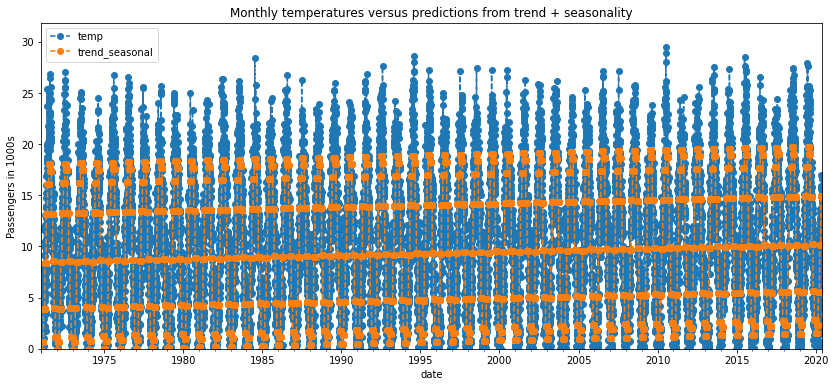

In [29]:
plot_timeseries(df_train[['temp', 'trend_seasonal']], 
                title="Monthly temperatures versus predictions from trend + seasonality")

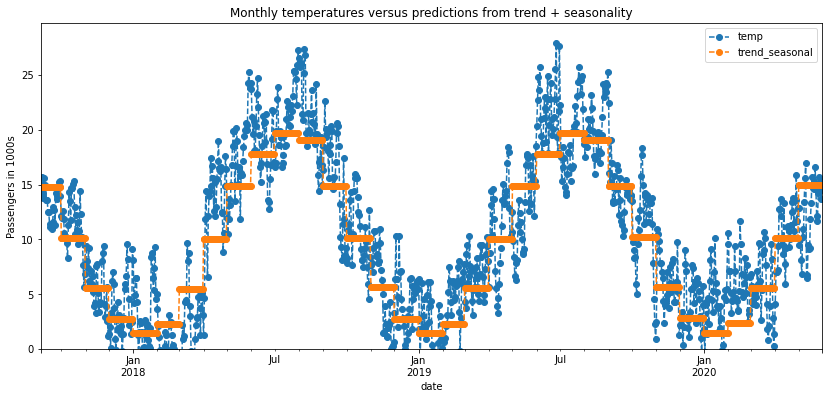

In [30]:
plot_timeseries(df_train[['temp', 'trend_seasonal']].iloc[-1000:], 
                title="Monthly temperatures versus predictions from trend + seasonality")

Conclusion: Plotting the last 1000 days we can see that our trend-seasonality model already folllows the original observations with surprising accuracy.

Next we will extract the remainder by subtracting the trend-seasonal model from the orginal data to explore the usefulness of this feature.

In [31]:
# extract remainder as a feature

df_train['remainder'] = df_train['temp'] - df_train['trend_seasonal']
df_test['remainder'] = df_test['temp'] - df_test['trend_seasonal']
df_train.head(1)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal,remainder
date,,,,,,,,,,,,,,,,
1971-01-01,-9.5,0,0,0,0,0,1,0,0,0,0,0,0,0,-0.197951,-9.302049


In [32]:
df_test.head(1)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal,remainder
date,,,,,,,,,,,,,,,,
2020-06-01,17.0,18049,0,0,0,0,0,0,1,0,0,0,0,0,17.833293,-0.833293


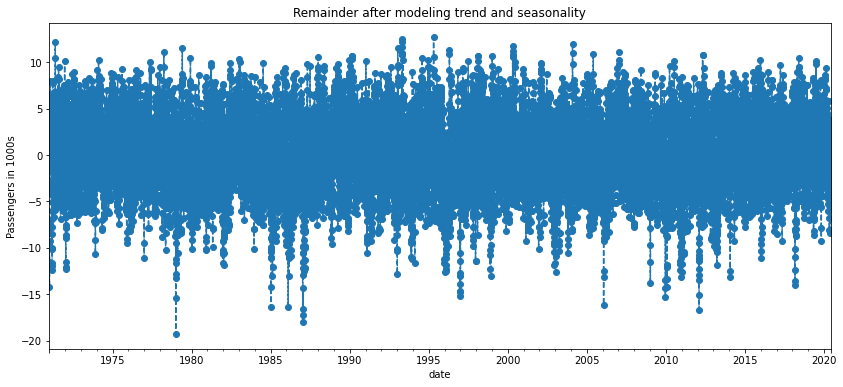

In [33]:
# plot remainder 
plot_timeseries(df_train['remainder'], title="Remainder after modeling trend and seasonality", ylim=False)

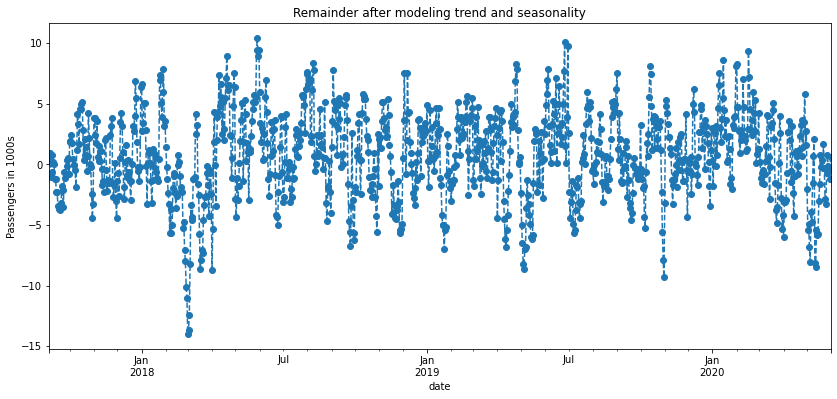

In [34]:
plot_timeseries(df_train['remainder'][-1000:], title="Remainder after modeling trend and seasonality", ylim=False)

Since the remainder appears to be a stationary time series with values at different time instants that seem correlated, we will introduces a lag feature of the remainder. We then add it to our model because we want better predictions for the main target temperature.

In [35]:
df_train['lag1'] = df_train['remainder'].shift(1)

df_train.head(1)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal,remainder,lag1
date,,,,,,,,,,,,,,,,,
1971-01-01,-9.5,0,0,0,0,0,1,0,0,0,0,0,0,0,-0.197951,-9.302049,NaN


In [36]:
# since received NAN-values when we created the lag features, we now erase those observations from our data frame

df_train.dropna(inplace=True)

df_train.head(1)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal,remainder,lag1
date,,,,,,,,,,,,,,,,,
1971-01-02,-9.6,1,0,0,0,0,1,0,0,0,0,0,0,0,-0.197855,-9.402145,-9.302049


## Step 7 - Inspectig the Remainder to Confirm Use of Linear Autoregression Model

We test if the lag of the remainder and the remainder are correlated.

<AxesSubplot:>

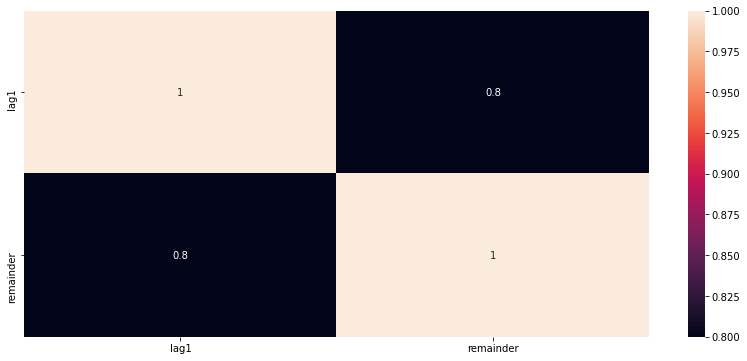

In [37]:
sns.heatmap(round(df_train[['lag1', 'remainder']].corr(), 2), annot=True)

Note: They are highly correlated.

<AxesSubplot:xlabel='lag1', ylabel='remainder'>

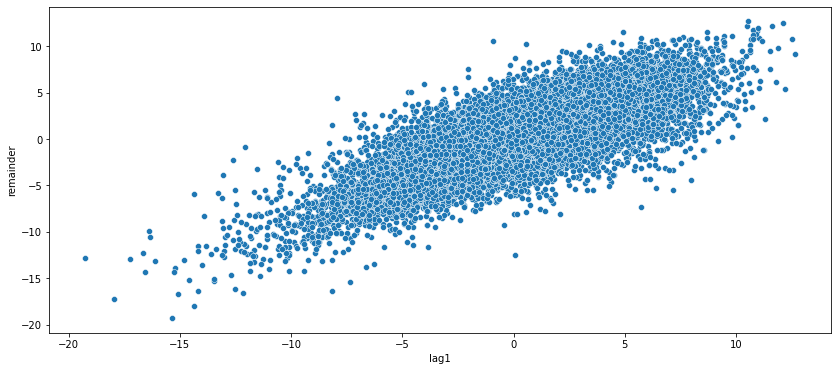

In [38]:
sns.scatterplot(x=df_train['lag1'], y=df_train['remainder'], data=df)
# plt.show()

Note: They are correlated in a linear way.

Performing a Dickey-Fuller Test to test for stationarity.

In [39]:
def perform_dickey_fuller_test(ts):
    result = adfuller(ts, autolag='AIC')
    print('ADF Statistic: %f' % result[0])
    print('p-value: %f' % result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))
perform_dickey_fuller_test(df_train['temp'])

ADF Statistic: -9.677790
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567


Note: The p-value of < 0.5 shows that the data is stationary.

Conclusion: Since the Lag and the remainder are linearly correlated and the additional assumptions, stationarity and the dependence the vriables deminshes over time, we will apply a linear Autoregression Model by adding a number of lags.

## Step 8 - Determining the Number of Lags - Box-Jenkins Methodology (ACF, PCF)

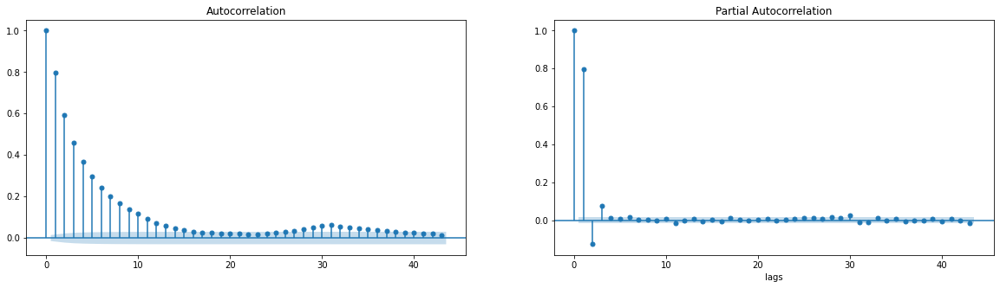

In [40]:
# Statsmodels provides a function called plot_pacf
# plot partial autocorrelation function
fig,(ax1,ax2) = plt.subplots(ncols=2)
fig.set_size_inches(20, 5)
plot_acf(df_train['remainder'],ax=ax1)
plot_pacf(df_train['remainder'],ax=ax2)

plt.xlabel('lags');

### Box-Jenkins Methodology

In order to select the model specification we want to look at the partial autocorrelation of the time series. The last lag before the partial autocorrelation plot cuts off is the number of lags that we might want to use as p value in our AR(P) model.

Conclusion 3 lags is a good value for p.

Confirming the number of lags with the statsmodels algorithm:

In [41]:
selected_order = ar_select_order(df_train['remainder'], maxlag = 12)

/Users/FelixAir/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/FelixAir/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:524: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


In [42]:
selected_order.ar_lags

array([1, 2, 3])

3 Lags are the best value

In [43]:
# adding more lags to the data frame according to our observation
# we do the same for the test data

df_train['lag2'] = df_train['remainder'].shift(2)
df_train['lag3'] = df_train['remainder'].shift(3)
df_train = df_train.dropna()

df_test['lag1'] = df_test['remainder'].shift(1)
df_test['lag2'] = df_test['remainder'].shift(2)
df_test['lag3'] = df_test['remainder'].shift(3)

df_train.head(3)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal,remainder,lag1,lag2,lag3
date,,,,,,,,,,,,,,,,,,,
1971-01-05,-8.3,4,0,0,0,0,1,0,0,0,0,0,0,0,-0.197567,-8.102433,-11.502337,-14.202241,-9.402145
1971-01-06,-9.5,5,0,0,0,0,1,0,0,0,0,0,0,0,-0.197472,-9.302528,-8.102433,-11.502337,-14.202241
1971-01-07,-7.6,6,0,0,0,0,1,0,0,0,0,0,0,0,-0.197376,-7.402624,-9.302528,-8.102433,-11.502337


In [44]:
df_train.tail(1)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal,remainder,lag1,lag2,lag3
date,,,,,,,,,,,,,,,,,,,
2020-05-31,15.5,18048,0,0,0,0,0,0,0,0,1,0,0,0,14.928814,0.571186,-1.228718,-0.428623,-0.128527


In [45]:
# here we can find the missing values of the test set in the training set and fill them with the correct values
df_test.loc['2020-06-01', 'lag1'] = df_train.loc['2020-05-31', 'remainder']
df_test.loc['2020-06-01', 'lag2'] = df_train.loc['2020-05-31', 'lag1']
df_test.loc['2020-06-01', 'lag3'] = df_train.loc['2020-05-31', 'lag2']

df_test.loc['2020-06-02', 'lag2'] = df_train.loc['2020-05-31', 'remainder']
df_test.loc['2020-06-02', 'lag3'] = df_train.loc['2020-05-31', 'lag1']

df_test.loc['2020-06-03', 'lag3'] = df_train.loc['2020-05-31', 'remainder']

df_test.head(3)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal,remainder,lag1,lag2,lag3
date,,,,,,,,,,,,,,,,,,,
2020-06-01,17.0,18049,0,0,0,0,0,0,1,0,0,0,0,0,17.833293,-0.833293,0.571186,-1.228718,-0.428623
2020-06-02,19.7,18050,0,0,0,0,0,0,1,0,0,0,0,0,17.833389,1.866611,-0.833293,0.571186,-1.228718
2020-06-03,18.5,18051,0,0,0,0,0,0,1,0,0,0,0,0,17.833485,0.666515,1.866611,-0.833293,0.571186


We now run the linear regression model on all the newly created features:
- 'timestep' to capture the trend
- 'months' to capture seasonality
- 'lag of the remainder' to capture time dependency to 3 previous days

In [46]:
# we now define our new X and y 
X = df_train.drop(['temp', 'trend_seasonal', 'remainder'], axis=1)
y = df_train['temp']

In [47]:
# instantiate and train the model, then add predictions on training data

m_full = LinearRegression().fit(X,y)

df_train['predictions_full'] = m_full.predict(X)
df_train.head(1)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal,remainder,lag1,lag2,lag3,predictions_full
date,,,,,,,,,,,,,,,,,,,,
1971-01-05,-8.3,4,0,0,0,0,1,0,0,0,0,0,0,0,-0.197567,-8.102433,-11.502337,-14.202241,-9.402145,-8.55048


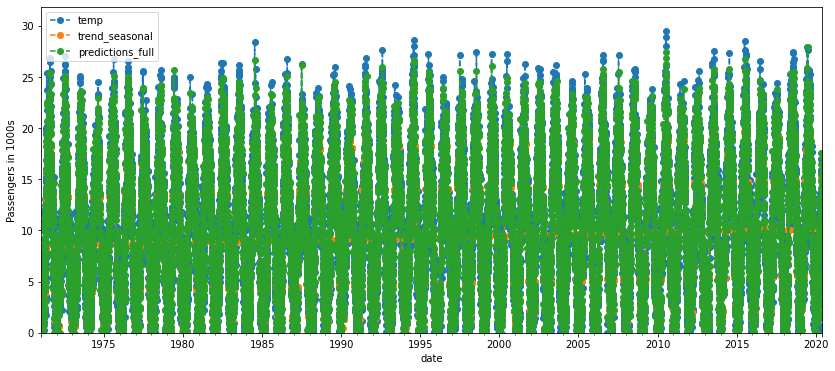

In [48]:
# plot target and predictions

plot_timeseries(df_train[['temp', 'trend_seasonal', 'predictions_full']])

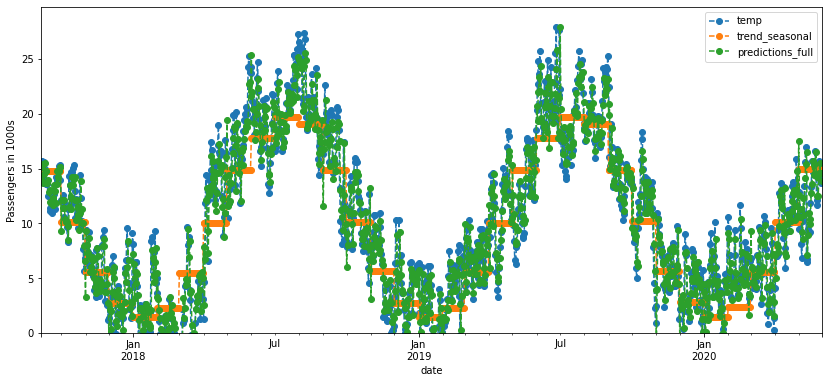

In [49]:
plot_timeseries(df_train[['temp', 'trend_seasonal', 'predictions_full']][-1000:])

Linear Regression Models have the big advantage that we can extract the coefficients of the model to determine the magnitude of the influence a feature has on the prediction.

In [50]:
# extracting full model coefficients

pd.DataFrame(m_full.coef_.reshape(1,16), columns=X.columns)

,timestep,April,August,December,February,January,July,June,March,May,November,October,September,lag1,lag2,lag3
0,0.000095,-0.27114,8.636515,-7.551002,-8.014009,-8.834408,9.362425,7.400892,-4.772197,4.479004,-4.721004,-0.186717,4.47164,0.909335,-0.196344,0.077509


## Step 9 - Evaluating our Model with Cross-Validation
To evaluate the robustness and accuracy of our model we perform a cross-validation of our training data.
The process goes as follows:
- Dividing training data into subsets (folds) - order respective to time is maintained
- in the first iteration, use the first fold to evaluate the second fold
- in the second iteration, use the first and thesecond fold to evaluate the third fold

In [51]:
# Create a TimeSeriesSplit object
ts_split = TimeSeriesSplit(n_splits=5)

time_cv = ts_split.split(X, y) # this is a python generator

In [52]:
# Split the training data into folds
for i, (train_index, validation_index) in enumerate(time_cv):
    print("The training data for iteration #{} are the observations steps  = {}".format(i+1, train_index))
    print("size of training data = {}".format(len(train_index)))
    print("The validation data for iteration #{} are the observations steps = {}".format(i+1, validation_index))
    print("size of validation data = {}".format(len(validation_index)))
    

The training data for iteration #1 are the observations steps  = [   0    1    2 ... 3007 3008 3009]
size of training data = 3010
The validation data for iteration #1 are the observations steps = [3010 3011 3012 ... 6014 6015 6016]
size of validation data = 3007
The training data for iteration #2 are the observations steps  = [   0    1    2 ... 6014 6015 6016]
size of training data = 6017
The validation data for iteration #2 are the observations steps = [6017 6018 6019 ... 9021 9022 9023]
size of validation data = 3007
The training data for iteration #3 are the observations steps  = [   0    1    2 ... 9021 9022 9023]
size of training data = 9024
The validation data for iteration #3 are the observations steps = [ 9024  9025  9026 ... 12028 12029 12030]
size of validation data = 3007
The training data for iteration #4 are the observations steps  = [    0     1     2 ... 12028 12029 12030]
size of training data = 12031
The validation data for iteration #4 are the observations steps = [1

In [53]:
# cross validate model and read scores 
time_cv = ts_split.split(X, y)

estimator = LinearRegression()

r_squared_scores = cross_val_score(estimator=estimator, X=X, y=y, cv=time_cv )

print(r_squared_scores)
print(r_squared_scores.mean())

[0.90682384 0.88625934 0.91174357 0.92037606 0.91318296]
0.9076771554038146


Conclusion: Our model's predictions have very similar R-Squared scores on all validation-folds. Therefore we can accept this as a validation that our model is not biased towards a certain time frame. The mean R-Suared score of 0.9076 tells us that approximately 90% of the observed variation between the variables can be explained by the model's inputs.

We are now ready to use our model on the test data.

## Step 10 - Runnning the AR(3) Model on the Test-Set

In [54]:
# make full model predictions

X_test = df_test.drop(['temp', 'trend_seasonal', 'remainder'], axis=1)
# Create the predictions
df_test['predictions_full'] = m_full.predict(X_test)

df_test.head(3)

,temp,timestep,April,August,December,February,January,July,June,March,May,November,October,September,trend_seasonal,remainder,lag1,lag2,lag3,predictions_full
date,,,,,,,,,,,,,,,,,,,,
2020-06-01,17.0,18049,0,0,0,0,0,0,1,0,0,0,0,0,17.833293,-0.833293,0.571186,-1.228718,-0.428623,18.534433
2020-06-02,19.7,18050,0,0,0,0,0,0,1,0,0,0,0,0,17.833389,1.866611,-0.833293,0.571186,-1.228718,16.841971
2020-06-03,18.5,18051,0,0,0,0,0,0,1,0,0,0,0,0,17.833485,0.666515,1.866611,-0.833293,0.571186,19.712455


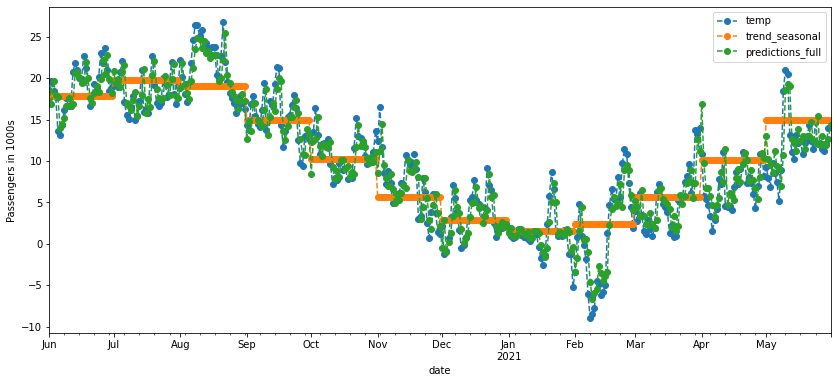

In [55]:
plot_timeseries(df_test[['temp', 'trend_seasonal', 'predictions_full']], ylim=False)

In [56]:
# let's check R squared score

print(r2_score(df_test['temp'], df_test['trend_seasonal']))

print(r2_score(df_test['temp'], df_test['predictions_full']))

0.7621943741645795
0.918429750978843


Conclusion: The model performs quite well with more than 91% of variation in our observation being explained by our model.

In order to select the model specification we want to look at the partial autocorrelation of the time series. The last lag before the partial autocorrelation plot cuts off is the number of lags that we might want to use as p value in our AR(P) model.

## Step 11 - Combining the Train- and Test-Set and Re-Training the Model

In [57]:
# join test and train data together

df_combined = df_train.append(df_test)
df_combined.tail()

# Re-train the model on the whole dataset
X_combined = df_combined.drop(columns=['temp', 'trend_seasonal', 'remainder', 'predictions_full'])
y_combined = df_combined['temp']

m_full_combined = LinearRegression()
m_full_combined.fit(X_combined, y_combined)

LinearRegression()

## Step 12 - Temperature Forecast for the Next Day and Comparison to new weather data

In [58]:
df_combined.index.max()

Timestamp('2021-05-31 00:00:00')

In [59]:
# generating features for the day after time point 2021-05-31

X_future = []

timestep = df_combined['timestep'].max() + 1
months = [0]*6 + [1] + [0]*5   #dummy code for June
lag1 = df_combined.loc['2021-05-31', 'remainder'] # taking the last remainder 
lag2 = df_train.loc['2020-05-31', 'lag1']
lag3 = df_train.loc['2020-05-31', 'lag2']

# appending the features to a list

X_future.append(timestep)
X_future.extend(months)
X_future.append(lag1)
X_future.append(lag2)
X_future.append(lag3)
X_future

# converting list into a data frame
X_future = pd.DataFrame([X_future])
X_future.columns = X_combined.columns

X_future

,timestep,April,August,December,February,January,July,June,March,May,November,October,September,lag1,lag2,lag3
0,18414,0,0,0,0,0,0,1,0,0,0,0,0,-0.863771,-1.228718,-0.428623


In [60]:

print("Prediction for 2021-06-01 is {} degrees".format(round(m_full_combined.predict(X_future)[0],2)))

Prediction for 2021-06-01 is 17.27 degrees


We will compare this to the actual data from [meteostat.net](https://meteostat.net/de/station/10381?t=2021-06-01/2021-06-01 'go to page')

In [61]:
actual_weather = pd.read_csv('data/dahlem_20210601.csv')
actual_mean_temp = actual_weather.temp.mean()
print("Weather station's data for 2021-06-01 shows {} degrees".format(round(actual_mean_temp,2)))

Weather station's data for 2021-06-01 shows 16.5 degrees


A difference of 0,77 degrees is satisfactory. With only the temperature and no other data this prediction for a day in June, where the temperature fluctuates a lot, is very precise. 

However, one could try to further improve the model by:
1. using shorter time intervals between for seasonality for example fortnights instead of months
2. looking into time frame the model is trained on and comparing the coefficients of the different models 